In [1]:
import pandas as pd
import numpy as np
import utils as u
import datetime as dt
from arctic import Arctic

import matplotlib.pyplot as plt
from matplotlib import cm
import matplotlib as mpl

In [2]:
# Connect to the local arctic store.
store = Arctic('localhost')
store.list_libraries()

['test', 'Tick_store']

In [3]:
library = store['Tick_store']
library.list_symbols()

['BTCUSD', 'BTCUSD_ob', 'BTCUSD_trades']

In [4]:
trades = library.read('BTCUSD_trades')
trades = trades['2021-02-21']
df = library.read('BTCUSD_ob')
df = df['2021-02-21']
df = df[:trades.index[-1]]
df_original = df.copy()

In [46]:
initial = df[df.index == df.index[0]]
changes = df[df.index != df.index[0]]

In [6]:
price_lvl = df.price.unique()
max_size = df['size'].quantile(0.9)
min_size = df['size'].quantile(0.1)
#max_size = df['size'].max(skipna=True)

start = df.index[0]
end = df.index[-1]

In [16]:
ob_initial = u.create_orderbook(initial)
ob_final, best_ask, best_bid, time = u.get_bid_ask(changes, ob_initial)

d = {'bid': best_bid, 'ask': best_ask}
time = pd.to_datetime(time)
ba = pd.DataFrame(data=d, index=time)

100%|██████████| 746022/746022 [00:35<00:00, 20768.03it/s]


In [31]:
ba_pct = ba.pct_change().dropna()

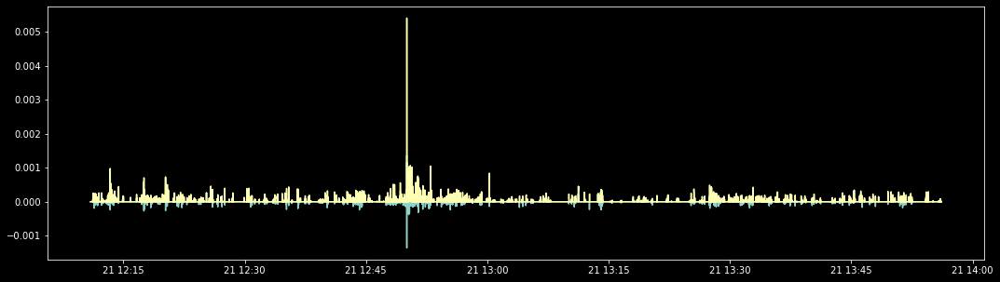

In [32]:
plt.figure(figsize=(18, 5))
plt.plot(ba_pct.ask)
plt.plot(abs(ba_pct.ask).rolling(20).sum())

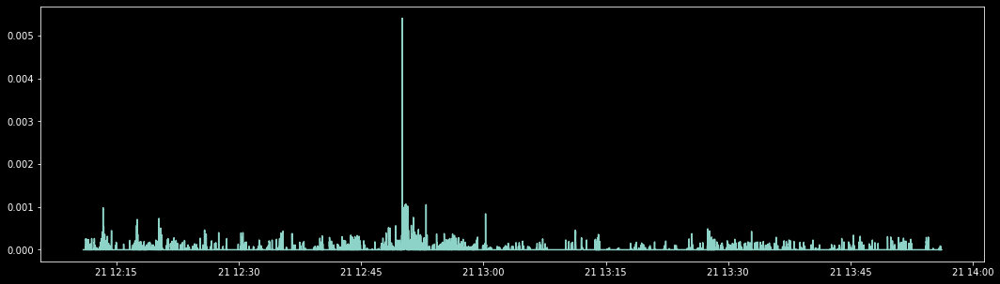

In [33]:
plt.figure(figsize=(18, 5))
plt.plot(abs(ba_pct.ask).rolling(20).sum())

In [34]:
det = pd.Series(np.where(abs(ba_pct.bid).rolling(20).sum() > abs(ba_pct.ask).rolling(20).sum()+0.0005, 1, 0), ba_pct.index)

In [35]:
changes = ba_pct.replace(0, np.nan).rolling(20).count()
changes = pd.Series(np.where(changes.ask > 15, 1, 0), changes.index)

In [37]:
colmap = cm.get_cmap('plasma', 50)
tmp = df.copy()

# Export relevant range of df
upper = 57260
lower = 57120

tmp = tmp[(tmp.price > lower) & (tmp.price < upper)]

price_lvl = tmp.price.unique()
max_size = tmp['size'].quantile(0.9)
min_size = tmp['size'].quantile(0.1)
y, x_start, x_end, col = u.create_levels(tmp, price_lvl, max_size, min_size, end, colmap)

100%|██████████| 279/279 [00:24<00:00, 11.55it/s]


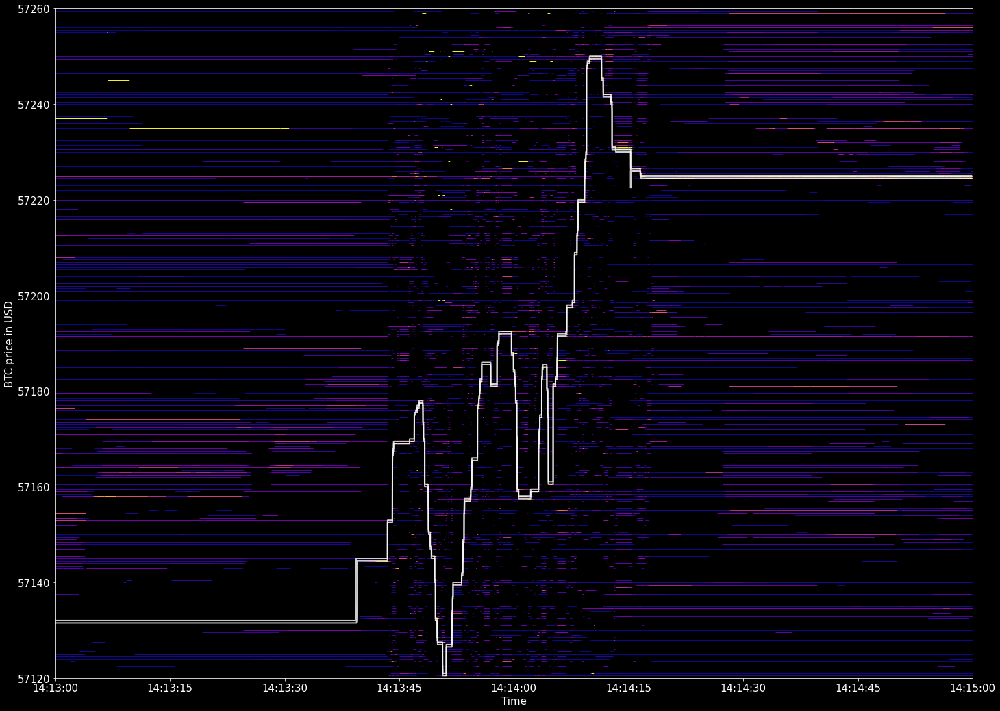

In [42]:
plt.style.use('dark_background')
plt.figure(figsize=(24, 18))
plt.rcParams.update({'font.size': 15})
plt.hlines(y, pd.to_datetime(x_start), pd.to_datetime(x_end), lw=1, color=col, alpha=1, zorder=0)
plt.plot(ba['2021-02-21 14:13':'2021-02-21 14:14'], label='Mid Price', color='w', lw=2, alpha=0.8)
plt.xlim('2021-02-21 13:13', '2021-02-21 13:15')
plt.ylim(lower, upper)
plt.xlabel('Time')
plt.ylabel('BTC price in USD')
plt.show()

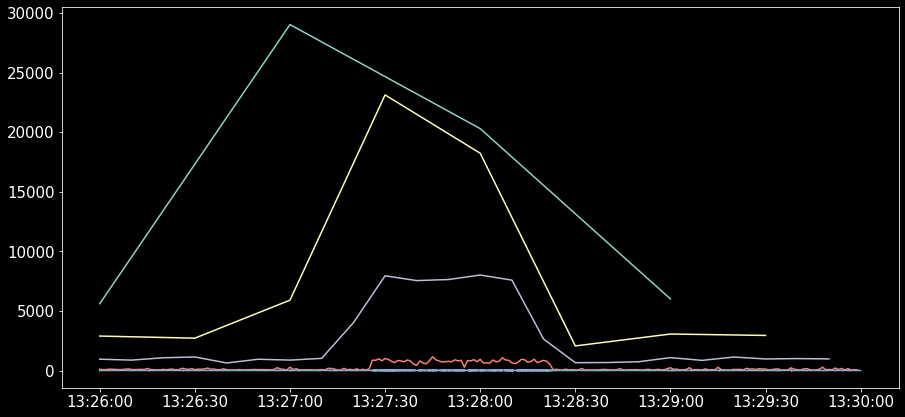

In [77]:
# Amount of orders per minute
# begin = changes.index[0] #'2021-02-21 14:12'
# end = changes.index[-1] #'2021-02-21 14:15'
begin = '2021-02-21 14:26'
end = '2021-02-21 14:29'

sixty_sec = changes.resample('60s').count().side
thirty_sec = changes.resample('30s').count().side
ten_sec = changes.resample('10s').count().side
one_sec = changes.resample('1s').count().side
one_milsec = changes.resample('ms').count().side

plt.style.use('dark_background')
plt.figure(figsize=(15, 7))
plt.plot(sixty_sec[begin:end])
plt.plot(thirty_sec[begin:end])
plt.plot(ten_sec[begin:end])
plt.plot(one_sec[begin:end])
plt.plot(one_milsec[begin:end])

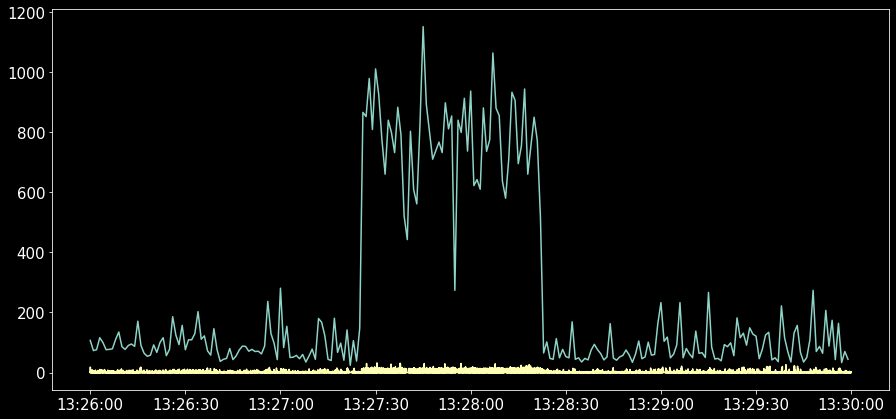

In [79]:
plt.style.use('dark_background')
plt.figure(figsize=(15, 7))
plt.plot(one_sec[begin:end])
plt.plot(one_milsec[begin:end])

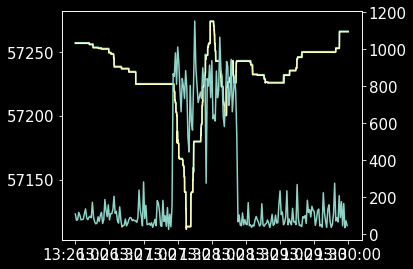

<Figure size 1080x504 with 0 Axes>

In [84]:
# Amount of orders per minute
fig, ax1 = plt.subplots()
ax1.plot(ba[begin:end])

ax2 = ax1.twinx()
ax2.plot(one_sec[begin:end])
#ax2.plot(one_milsec[begin:end])

fig.tight_layout() 

plt.style.use('dark_background')
plt.figure(figsize=(15, 7))
plt.show()

In [96]:
# Trade Volume Analysis

vol_onemin = trades['size'].resample('1min').sum()
vol_thirtysec = trades['size'].resample('30s').sum()
vol_tensec = trades['size'].resample('10s').sum()
vol_onesec = trades['size'].resample('1s').sum()

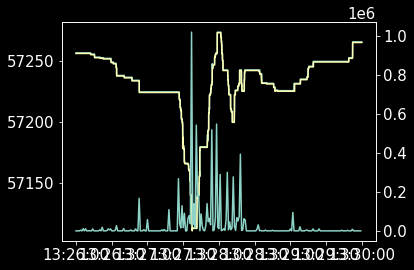

<Figure size 1080x504 with 0 Axes>

In [98]:
fig, ax1 = plt.subplots()
ax1.plot(ba[begin:end])

ax2 = ax1.twinx()
ax2.plot(vol_onesec[begin:end])
#ax2.plot(vol_tensec[begin:end])

fig.tight_layout() 

plt.style.use('dark_background')
plt.figure(figsize=(15, 7))
plt.show()